# Comparative Exploration of the Zebrahub (ZH) and ZESTA (ZS) Datasets

## Importing the Python and R Packages

In [ ]:
conda activate rick

In [1]:
# Python Packages
import numpy as np
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import seaborn as sns   ##For data visualization
import os
import anndata as ad
import sys
import tabulate
import copy
import matplotlib.pyplot as plt
from scipy.stats import median_abs_deviation
from scipy.sparse import issparse
from matplotlib.pyplot import rc_context
# import anndata2ri # Only if we want to convert between Scanpy and Seurat
# import logging
# os.environ["R_HOME"] = f"{os.environ['CONDA_PREFIX']}\\Lib\\R"
# import rpy2
# import rpy2.robjects as ro
# from rpy2.robjects.packages import importr
# from rpy2.robjects import pandas2ri
# from rpy2.robjects.conversion import localconverter
# pd_df = pd.DataFrame({'int_values': [1,2,3], 'str_values': ['abc', 'def', 'ghi']})
# base = importr('base')
# with localconverter(ro.default_converter + pandas2ri.converter): df_summary = base.summary(pd_df)
# import rpy2.rinterface_lib.callbacks as rcb
# rcb.logger.setLevel(logging.ERROR)
# ro.pandas2ri.activate()
# anndata2ri.activate()

from matplotlib.pyplot import rc_context
from warnings import simplefilter
simplefilter(action="ignore", category=pd.errors.PerformanceWarning) # Mutes warnings
import warnings
warnings.filterwarnings("ignore", message=".*The 'nopython' keyword.*")
##Installs all the required packages for scanpy
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')  ##These are the presets for Scanpy
results = 'write/saved.h5ad'  ##Output destination, by default in the same directory as the script location

scanpy==1.9.3 anndata==0.9.2 umap==0.5.3 numpy==1.24.4 scipy==1.11.1 pandas==2.0.3 scikit-learn==1.2.2 statsmodels==0.14.0 python-igraph==0.10.6 pynndescent==0.5.10


## Loading the timepoints from the datasets

In [2]:
# Importing the ZESTA Timepoints
zs3=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/ZESTA Liu 2022 ST/zf3.3_scRNA.h5ad') # 7424 × 22364
zs5=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/ZESTA Liu 2022 ST/zf5.25_scRNA.h5ad') # 7136 × 22089
zs10=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/ZESTA Liu 2022 ST/zf10_scRNA.h5ad') # 8755 × 22316
zs12=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/ZESTA Liu 2022 ST/zf12_scRNA.h5ad') # 12133 × 23016
zs18=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/ZESTA Liu 2022 ST/zf18_scRNA.h5ad') # 9903 × 23986
zs24 = sc.read_h5ad('C:/Users/Lekvenadmin/RSS/ZESTA Liu 2022 ST/zf24_scRNA.h5ad') # 14882 × 24197
# Importing the Zebrahub Timepoints
zh10=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/10hpf/zf_atlas_10hpf_v1_release.h5ad') # 1251 x 32060
zh12=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/12hpf/zf_atlas_12hpf_v1_release.h5ad') # 6699 x 32060
zh14=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/14hpf/zf_atlas_14hpf_v1_release.h5ad') # 3862 x 32060
zh16=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/16hpf/zf_atlas_16hpf_v1_release.h5ad') # 6297 x 32060
zh19=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/19hpf/zf_atlas_19hpf_v1_release.h5ad') # 5899 x 32060
zh24=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/24hpf/zf_atlas_24hpf_v1_release.h5ad') # 12914 x 32060
zh2d=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/2dpf/zf_atlas_2dpf_v1_release.h5ad') # 15483 x 32060
zh3d=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/3dpf/zf_atlas_3dpf_v1_release.h5ad') # 22473 x 32060
zh5d=sc.read_h5ad('C:/Users/Lekvenadmin/RSS/Zebrahub/5dpf/zf_atlas_5dpf_v1_release.h5ad') # 24987 x 32060

## QC, Preprocessing (Normalization, Regression, Scaling), and Cell Population Filtering

### Zebrahub 12hpf

normalizing counts per cell
    finished (0:00:00)


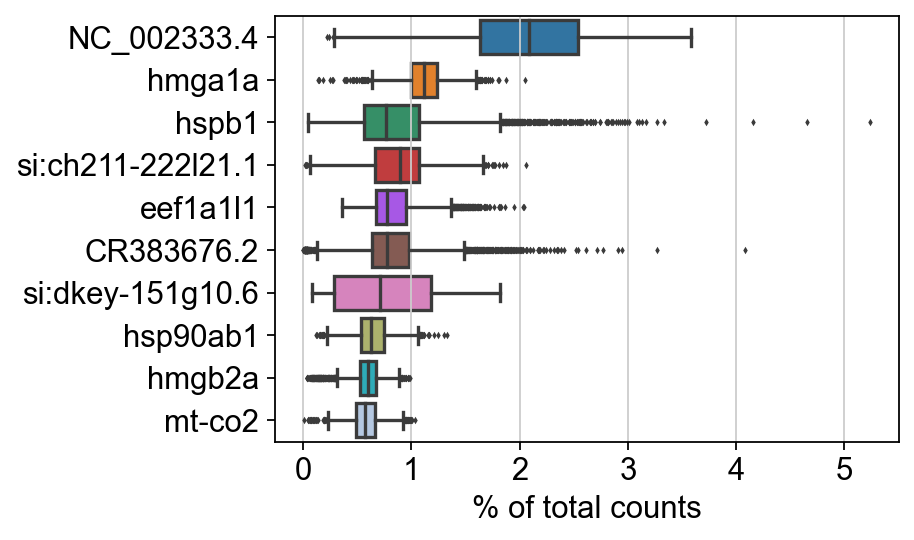

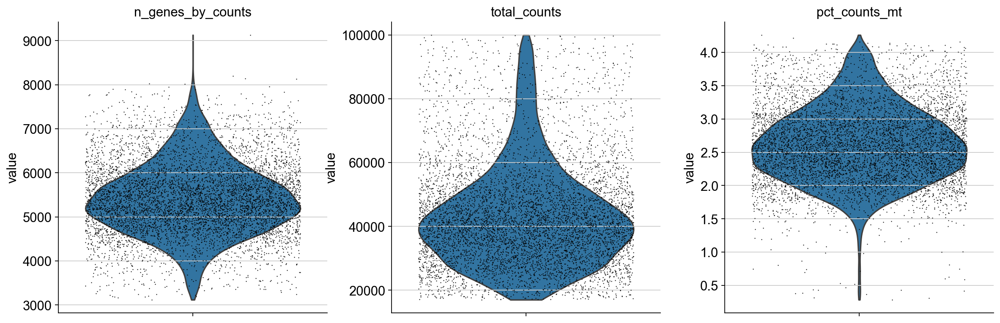

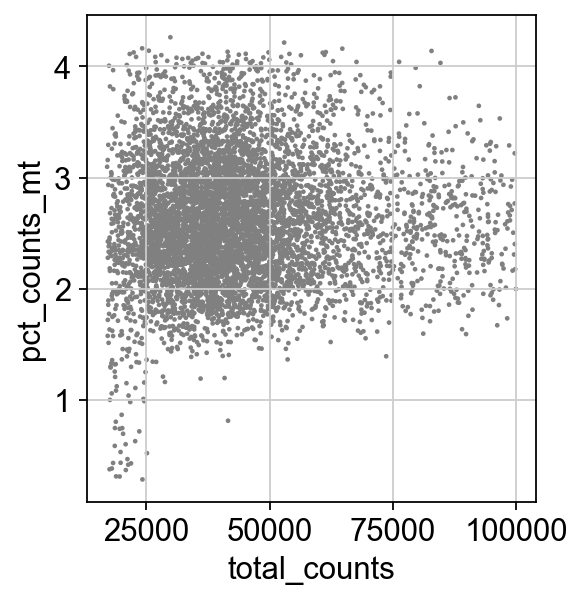

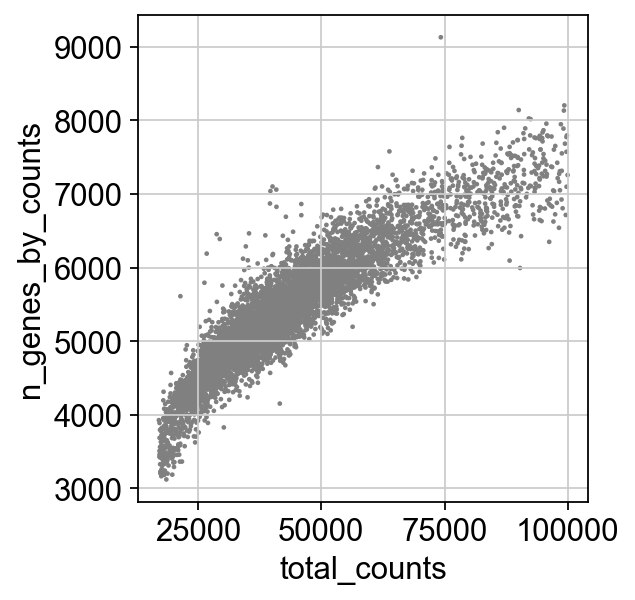

The ZFA Cell types in the 12hpf timepoint are:
['somite' 'midbrain hindbrain boundary neural keel'
 'hindbrain neural plate' 'hindbrain neural keel' 'lateral mesoderm'
 'ectodermal cell' 'notochord' 'tail bud' 'presumptive diencephalon'
 'endoderm' 'anterior neural keel' 'floor plate' 'adaxial cell'
 'paraxial mesoderm' 'polster' 'segmental plate' 'neural crest'
 'presumptive telencephalon' 'neurogenic placode' 'lateral plate mesoderm'
 'periderm' 'primordial germ cell' 'yolk syncytial layer']


Please select number of genes at the doublet cutoff based on the violin plot  8000


You chose 8000 genes as the cutoff


C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:02:04)


In [4]:
##12hpf Zebrahub
sc.pl.highest_expr_genes(zh12, n_top=10) ##Show those genes that yield the highest fraction of counts in each single cell, across all cells
##Calculating %mt genes
zh12.var['mt'] = zh12.var_names.str.startswith('mt')
sc.pp.calculate_qc_metrics(zh12, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(zh12, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], jitter=0.4, multi_panel=True) ##Violin plot
##To check which cells have too many mitochondrial genes or too many transcript counts
sc.pl.scatter(zh12, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(zh12, x='total_counts', y='n_genes_by_counts')
##Getting ZFA Labels
zh12.write_csvs('out', sep=',') ##Generates a csv from obs dimension
zh12_df = pd.read_csv('./out/obs.csv') ##creates a dataframe from the saved csv
print("The ZFA Cell types in the 12hpf timepoint are:")
print(zh12_df.zebrafish_anatomy_ontology_class.unique()) ##lists what anatomy ontology terms are present in this dataset
##Filtering, normalizing, regressing, and scaling the cell subset (Pre-processing steps)
sc.pp.filter_cells(zh12, min_genes=200)
cutoff = input("Please select number of genes at the doublet cutoff based on the violin plot ")
print("You chose " + str(cutoff) + " genes as the cutoff")
zh12_filtered = zh12[zh12.obs.n_genes_by_counts < int(cutoff)]
zh12_filtered = zh12_filtered[zh12_filtered.obs.pct_counts_mt < 5 , :]
zh12_filtered
sc.pp.normalize_total(zh12_filtered, target_sum=1e4)
sc.pp.log1p(zh12_filtered)
sc.pp.regress_out(zh12_filtered, ['total_counts', 'pct_counts_mt'])
sc.pp.scale(zh12_filtered, max_value=10)
##Subsetting neural identity cells and computing PCA
##Choosing cell subset
zh12_neural = zh12_filtered[zh12_filtered.obs.zebrafish_anatomy_ontology_class.isin(['midbrain hindbrain boundary neural keel'] +['hindbrain neural plate']+['hindbrain neural keel']+['ectodermal cell']+['presumptive diencephalon']+['anterior neural keel']+['floor plate']+['segmental plate']+['presumptive telencephalon']+['neurogenic placode'])]

## Calculating PCs and Constructing Clusters & UMAPS

In [26]:
# Setting resolution of figures
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=150, frameon=False, vector_friendly=True, fontsize=12, format='png')

### Zebrahub 12hpf

Please define the total number of PCs for the sc.tl.pca() function 50


computing PCA
    with n_comps=50
    finished (0:00:06)


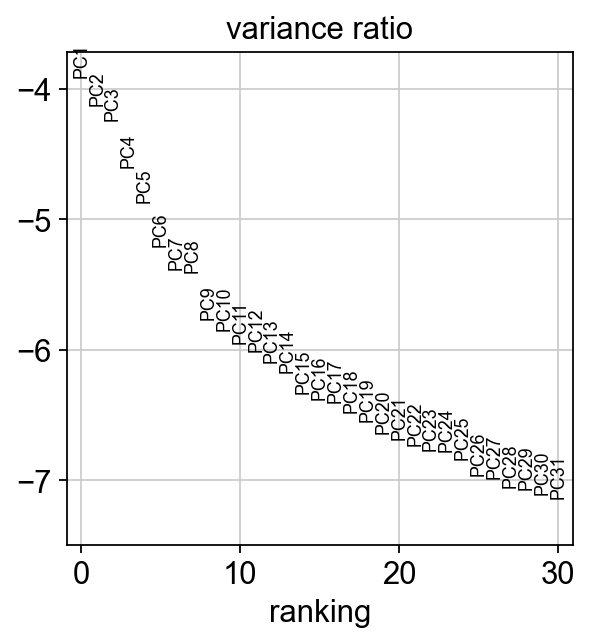

Please select the PC cutoff number to use for neighbors() function  40


You have chosen 40 pcs. Executing calculations.
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


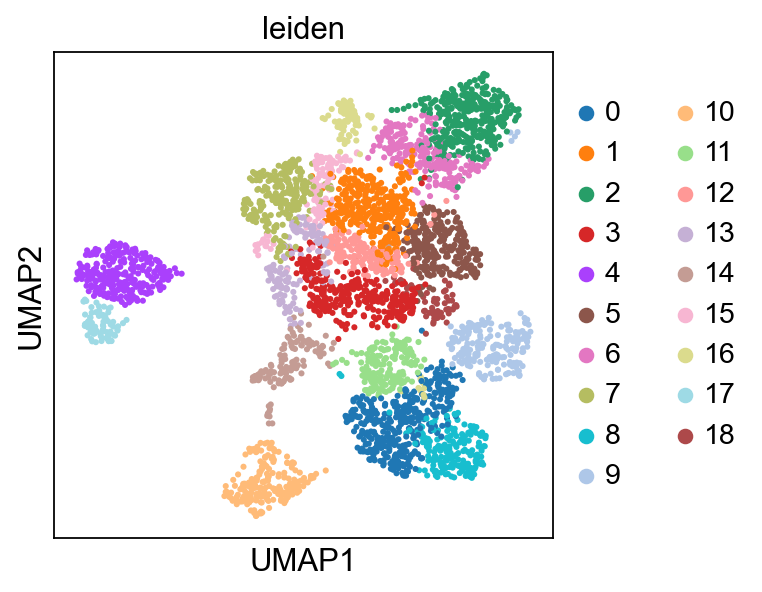

C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


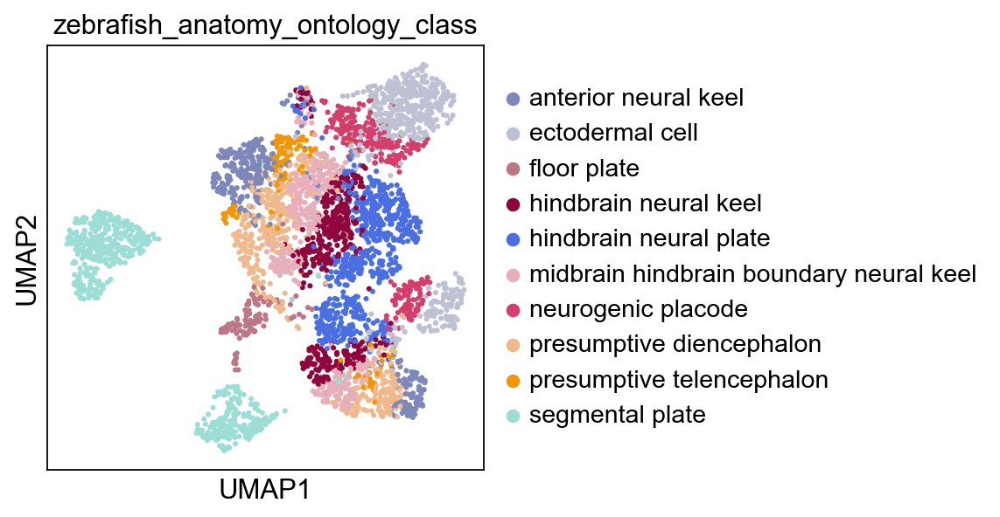

ranking genes


C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchange

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:25)


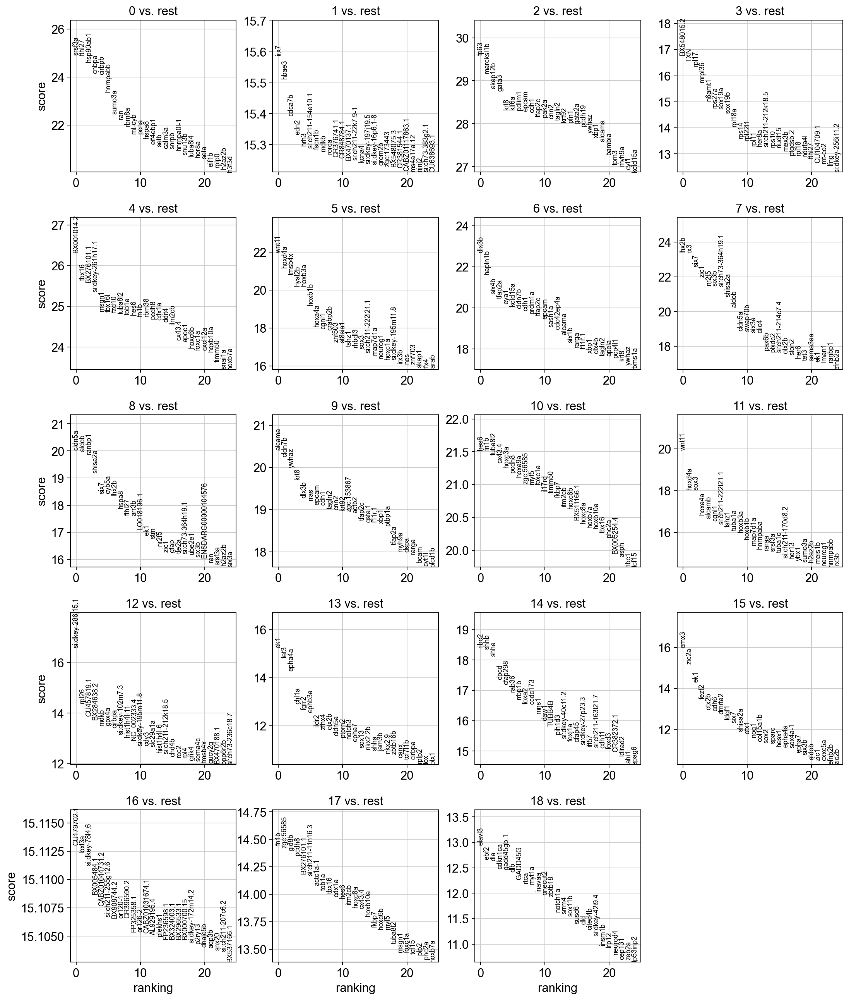

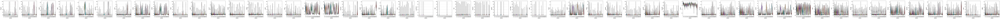

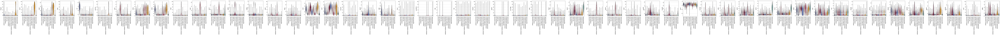

C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


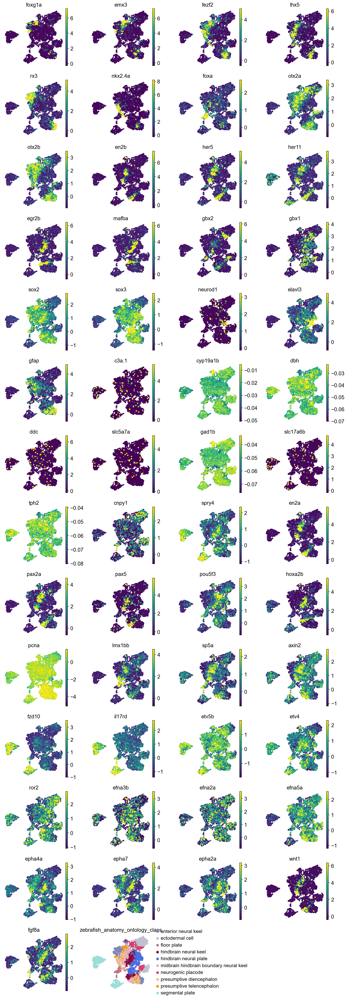

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: Forebrain, Midbrain, Hindbrain, etc.


C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


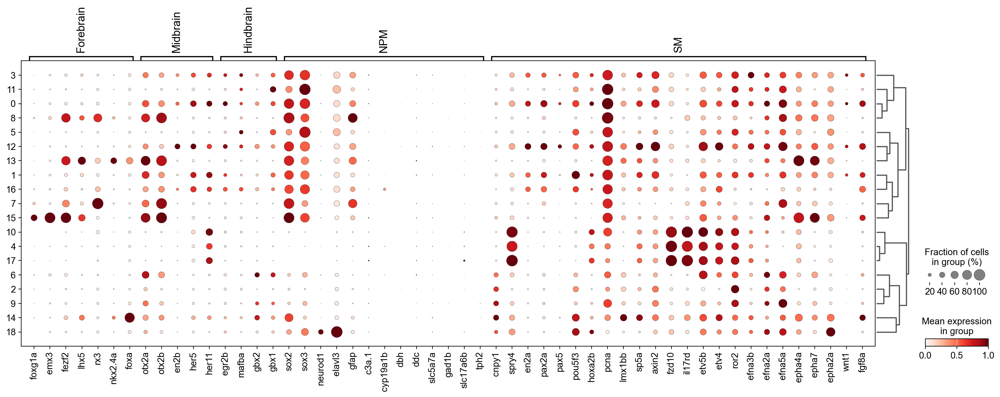

categories: anterior neural keel, ectodermal cell, floor plate, etc.
var_group_labels: Forebrain, Midbrain, Hindbrain, etc.


C:\Users\Lekvenadmin\anaconda3\envs\rick\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


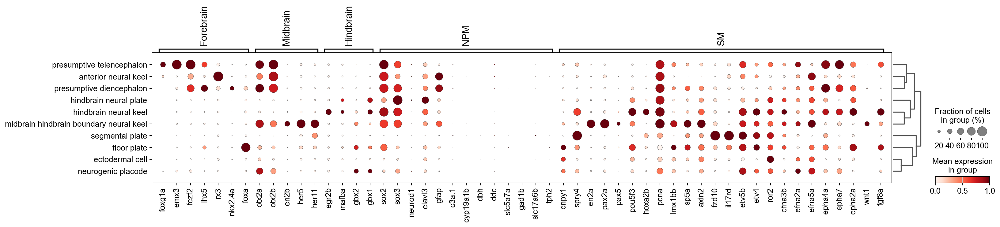

categories: 0, 1, 2, etc.
var_group_labels: Forebrain, Midbrain, Hindbrain, etc.


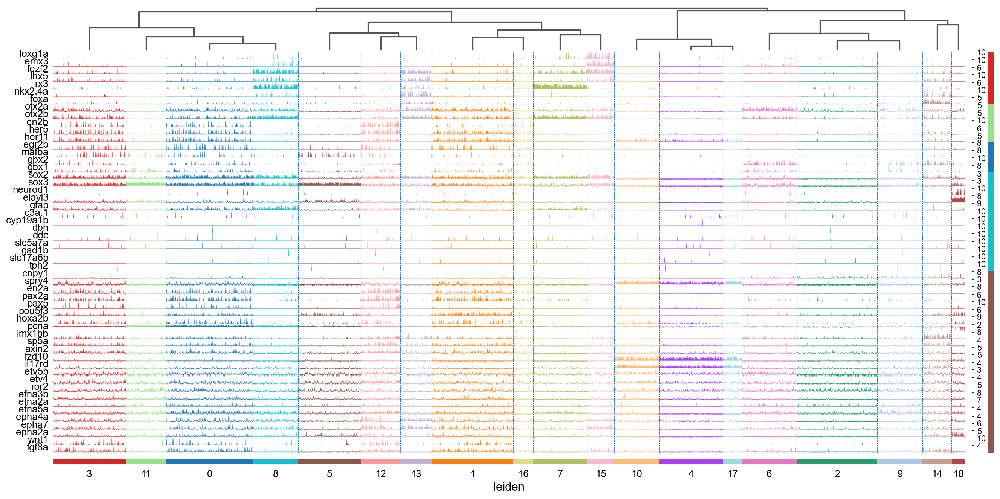

In [43]:
# Here is where we can play with the hyperparameters to get different clustering: sc.tl.pca, sc.pp.neighbors, 
# sc.tl.umap, and sc.tl.leiden
##Computing PCA
maxpcs = input("Please define the total number of PCs for the sc.tl.pca() function")
sc.tl.pca(zh12_neural, svd_solver='arpack', n_comps=int(maxpcs))
sc.pl.pca_variance_ratio(zh12_neural, log=True)
##Computing UMAP
pcs = input("Please select the PC cutoff number to use for neighbors() function ")
print("You have chosen " + str(pcs) + " pcs. Executing calculations.")
sc.pp.neighbors(zh12_neural, n_neighbors=10, n_pcs=int(pcs))
sc.tl.umap(zh12_neural, random_state=1)
sc.tl.leiden(zh12_neural, random_state=1)
##Saving neural dataset
zh12_neural.write_h5ad(filename = 'neural_clusters_zebrahub_zh12hpf.h5ad')
sc.pl.umap(zh12_neural, color=['leiden'], save=f' {pcs}-{maxpcs} zh12_neural.png')
sc.pl.umap(zh12_neural, color=['zebrafish_anatomy_ontology_class'], save=f' {pcs}-{maxpcs} ZFA zh12_neural.png')
##Computing marker genes
sc.tl.rank_genes_groups(zh12_neural, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(zh12_neural, n_genes=25, sharey=False, save=f' {pcs}-{maxpcs} zh12_neural.png')
##Plotting stacked violin plots with cluster grouping
sc.pl.violin(zh12_neural, ['foxg1a', 'emx3', 'fezf2', 'lhx5', 'rx3', 'nkx2.4a', 'foxa', 'otx2a', 'otx2b', 'en2b', 'her5', 'her11', 'egr2b', 'mafba', 'gbx2', 'gbx1', 'sox2', 'sox3', 'neurod1', 'elavl3', 'gfap', 'c3a.1', 'cyp19a1b', 'dbh', 'ddc', 'slc5a7a', 'gad1b', 'slc17a6b', 'tph2', 'cnpy1', 'spry4', 'en2a', 'pax2a', 'pax5', 'pou5f3', 'hoxa2b', 'pcna', 'lmx1bb', 'sp5a', 'axin2', 'fzd10', 'il17rd', 'etv5b', 'etv4',  'ror2', 'efna3b', 'efna2a', 'efna5a', 'epha4a', 'epha7', 'epha2a', 'wnt1', 'fgf8a'], groupby='leiden', size=1, save=f' {pcs}-{maxpcs} zh12_neural.png')
##Plotting stacked violin plots with zebrafish_anatomy_ontology_class grouping
sc.pl.violin(zh12_neural, ['foxg1a', 'emx3', 'fezf2', 'lhx5', 'rx3', 'nkx2.4a', 'foxa', 'otx2a', 'otx2b', 'en2b', 'her5', 'her11', 'egr2b', 'mafba', 'gbx2', 'gbx1', 'sox2', 'sox3', 'neurod1', 'elavl3', 'gfap', 'c3a.1', 'cyp19a1b', 'dbh', 'ddc', 'slc5a7a', 'gad1b', 'slc17a6b', 'tph2', 'cnpy1', 'spry4', 'en2a', 'pax2a', 'pax5', 'pou5f3', 'hoxa2b', 'pcna', 'lmx1bb', 'sp5a', 'axin2', 'fzd10', 'il17rd', 'etv5b', 'etv4',  'ror2', 'efna3b', 'efna2a', 'efna5a', 'epha4a', 'epha7', 'epha2a', 'wnt1', 'fgf8a'], groupby='zebrafish_anatomy_ontology_class', rotation=90, size=1, save=f' {pcs}-{maxpcs} ZFA zh12_neural.png')
##Plotting feature maps
with rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(zh12_neural, color=['foxg1a', 'emx3', 'fezf2', 'lhx5', 'rx3', 'nkx2.4a', 'foxa', 'otx2a', 'otx2b', 'en2b', 'her5', 'her11', 'egr2b', 'mafba', 'gbx2', 'gbx1', 'sox2', 'sox3', 'neurod1', 'elavl3', 'gfap', 'c3a.1', 'cyp19a1b', 'dbh', 'ddc', 'slc5a7a', 'gad1b', 'slc17a6b', 'tph2', 'cnpy1', 'spry4', 'en2a', 'pax2a', 'pax5', 'pou5f3', 'hoxa2b', 'pcna', 'lmx1bb', 'sp5a', 'axin2', 'fzd10', 'il17rd', 'etv5b', 'etv4',  'ror2', 'efna3b', 'efna2a', 'efna5a', 'epha4a', 'epha7', 'epha2a', 'wnt1', 'fgf8a', 'zebrafish_anatomy_ontology_class'], s=50, frameon=False, ncols=4, vmax='p99', save=f' {pcs}-{maxpcs} feature map zh12_neural.png')
##Defines a dictionary for markers and their associated populations
marker_genes_dict = {'Forebrain': ['foxg1a', 'emx3', 'fezf2', 'lhx5', 'rx3', 'nkx2.4a', 'foxa'],
	'Midbrain': ['otx2a', 'otx2b', 'en2b', 'her5', 'her11'],
	'Hindbrain': ['egr2b', 'mafba', 'gbx2', 'gbx1'],
    'NPM': ['sox2', 'sox3', 'neurod1', 'elavl3', 'gfap', 'c3a.1', 'cyp19a1b', 'dbh', 'ddc', 'slc5a7a', 'gad1b', 'slc17a6b', 'tph2'],
    'SM' : ['cnpy1', 'spry4', 'en2a', 'pax2a', 'pax5', 'pou5f3', 'hoxa2b', 'pcna', 'lmx1bb', 'sp5a', 'axin2', 'fzd10', 'il17rd', 'etv5b', 'etv4',  'ror2', 'efna3b', 'efna2a', 'efna5a', 'epha4a', 'epha7', 'epha2a', 'wnt1', 'fgf8a']}
##Creates a dotplot based on leiden clusters then on the anatomy ontology annotations
sc.tl.dendrogram(zh12_neural, groupby='leiden')
ax = sc.pl.dotplot(zh12_neural, marker_genes_dict, groupby="leiden", dendrogram = True, standard_scale='var', save=f' {pcs}-{maxpcs} zh12_neural.png')
ax = sc.pl.dotplot(zh12_neural, marker_genes_dict, groupby="zebrafish_anatomy_ontology_class", dendrogram = True, standard_scale='var', save=f' {pcs}-{maxpcs} ZFA zh12_neural.png')
sc.pl.tracksplot(zh12_neural, var_names=marker_genes_dict, groupby='leiden', dendrogram=True, figsize=[20, 10], save=f' {pcs}-{maxpcs} zh12_neural.png')